<a href="https://colab.research.google.com/github/Mayukh-Mondal-Dev/Hybrid-SSRN-Vision-Transformer-Architecture-For-Hyperspectral-Image-Classification/blob/main/Hybrid_Vision_Transformer_Architecture_For_Hyperspectral_Image_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#</center>Hyperspecral Image Classification</center>

### Importing Modules

In [ ]:
import numpy as np
import torch
from operator import truediv
import torch.utils.data as Data
from sklearn import metrics, preprocessing
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, accuracy_score, classification_report, cohen_kappa_score
from plotly.offline import init_notebook_mode
import matplotlib.pyplot as plt
import scipy.io as sio
import os
!pip install spectral
import spectral
import cv2
from IPython import display
import math
import torch.nn as nn
import torch.nn.functional as F
from torch.nn import init
from torchsummary import summary
!pip install einops
from einops import rearrange, repeat
init_notebook_mode(connected=True)
%matplotlib inline

!pip install torch-optimizer
import torch_optimizer as optim2
from torch import optim
import time
import collections

In [ ]:
#Making forlder for storing classification maps

!mkdir -p ./content/classification_maps

### Visualizing the Hyperspectral Images from Indian Pines Dataset using Matplotlib

#### Loading Datasets

In [ ]:
!pip install wget
import wget

# Check if files exist, download if not
if not (os.path.isfile('./content/Indian_pines_corrected.mat')):
    wget.download('http://www.ehu.eus/ccwintco/uploads/6/67/Indian_pines_corrected.mat', './content/Indian_pines_corrected.mat')

if not (os.path.isfile('./content/Indian_pines_gt.mat')):
    wget.download('http://www.ehu.eus/ccwintco/uploads/c/c4/Indian_pines_gt.mat', './content/Indian_pines_gt.mat')


#### Visualizing the Hyperspectral Images

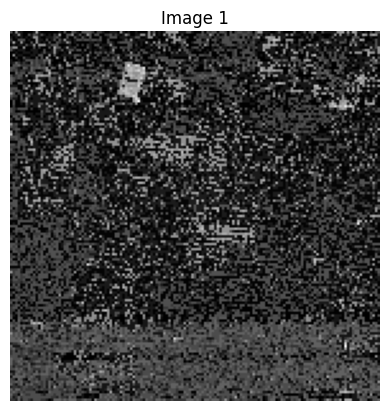

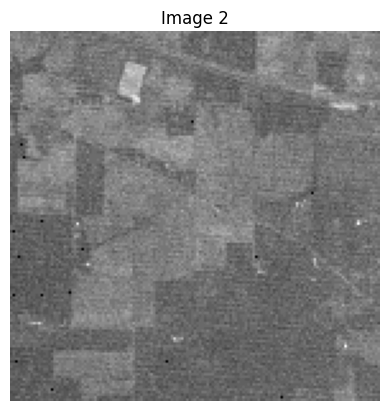

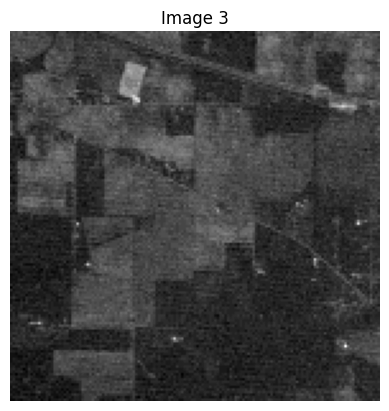

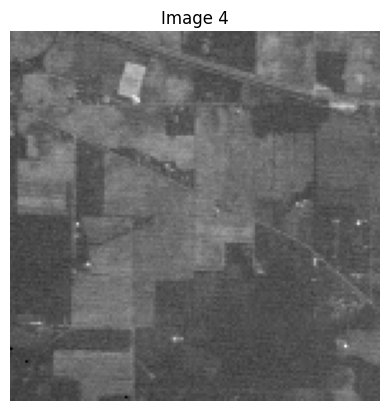

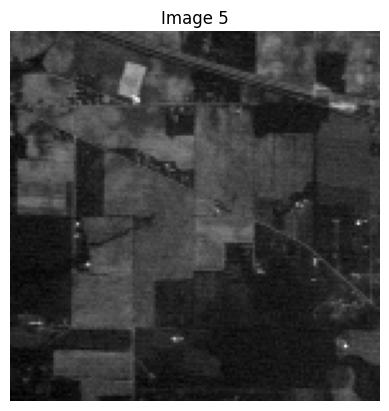

...

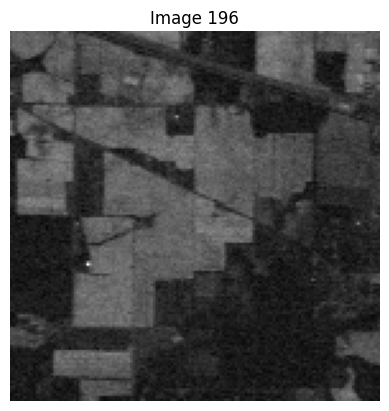

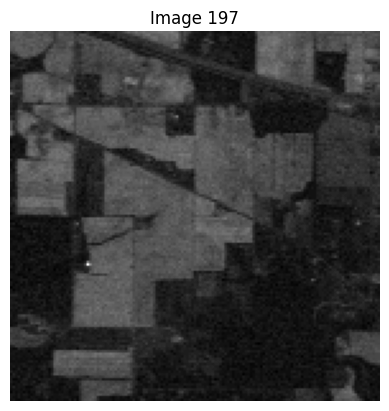

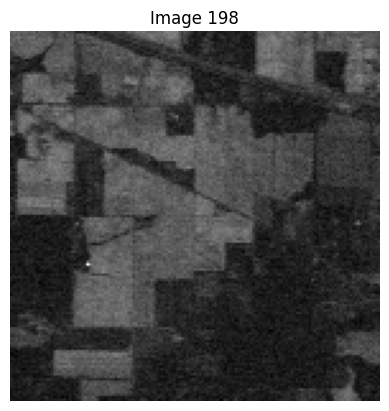

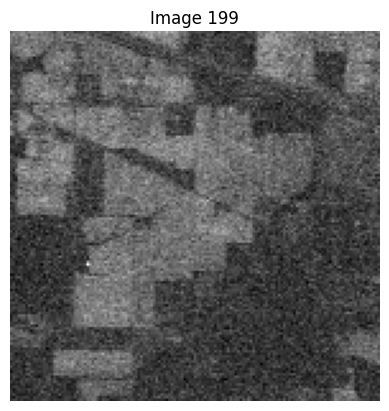

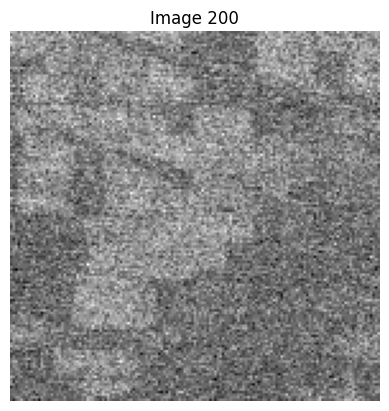

In [ ]:
import matplotlib.pyplot as plt

# Load MATLAB file
mat_data = sio.loadmat('content/Indian_pines_corrected.mat')

images = mat_data['indian_pines_corrected']

# Visualize each image
for i in range(images.shape[2]):
    plt.figure()
    plt.imshow(images[:, :, i], cmap='gray')
    plt.title('Image {}'.format(i+1))
    plt.axis('off')
    plt.show()

#### Visualizing Ground Truth with 'Jet' Cmap

Ground truth map shape: (145, 145)


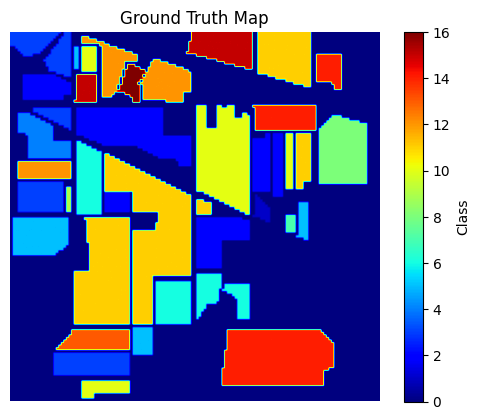

In [ ]:
mat_data = sio.loadmat('content/Indian_pines_gt.mat')
ground_truth_map = mat_data['indian_pines_gt']
print("Ground truth map shape:", ground_truth_map.shape)

plt.figure()
plt.imshow(ground_truth_map, cmap='jet')  # Assuming categorical labels, using 'jet' colormap
plt.title('Ground Truth Map')
plt.colorbar(label='Class')
plt.axis('off')
plt.show()

### Extracting Data and Ground Truth for Validation Split

In [ ]:
global Dataset
Dataset = "IN"

def load_dataset(Dataset):
        mat_data = sio.loadmat('./content/Indian_pines_corrected.mat')
        mat_gt = sio.loadmat('./content/Indian_pines_gt.mat')
        data_hsi = mat_data['indian_pines_corrected']
        gt_hsi = mat_gt['indian_pines_gt']
        K = 200
        TOTAL_SIZE = 10249
        VALIDATION_SPLIT = 0.90
        TRAIN_SIZE = math.ceil(TOTAL_SIZE * VALIDATION_SPLIT)
        # print(data_hsi, gt_hsi, TOTAL_SIZE, TRAIN_SIZE, VALIDATION_SPLIT)
        return data_hsi, gt_hsi, TOTAL_SIZE, TRAIN_SIZE, VALIDATION_SPLIT



### Preprocessing and Initialization for Hyperspectral Image Classification

In [ ]:
import math
data_hsi, gt_hsi, TOTAL_SIZE, TRAIN_SIZE, VALIDATION_SPLIT = load_dataset(Dataset)

# Print the shape of the hyperspectral data
print(data_hsi.shape)

# Extract dimensions from the data shape
image_x, image_y, BAND = data_hsi.shape

# Reshape the data for processing
data = data_hsi.reshape(np.prod(data_hsi.shape[:2]), np.prod(data_hsi.shape[2:]))
gt = gt_hsi.reshape(np.prod(gt_hsi.shape[:2]),)

# Determine the number of classes
CLASSES_NUM = max(gt)
print('The class numbers of the HSI data is:', CLASSES_NUM)

# Import and set parameters for the model
print('-----Importing Setting Parameters-----')
ITER = 1
PATCH_LENGTH = 4
lr, num_epochs, batch_size = 0.001, 100, 32
loss = torch.nn.CrossEntropyLoss()

# Calculate additional parameters based on data dimensions
img_rows = 2 * PATCH_LENGTH + 1
img_cols = 2 * PATCH_LENGTH + 1
img_channels = data_hsi.shape[2]
INPUT_DIMENSION = data_hsi.shape[2]
ALL_SIZE = data_hsi.shape[0] * data_hsi.shape[1]
VAL_SIZE = int(TRAIN_SIZE)
TEST_SIZE = TOTAL_SIZE - TRAIN_SIZE

# Initialize lists for storing metrics and results
KAPPA = []
OA = []
AA = []
TRAINING_TIME = []
TESTING_TIME = []
ELEMENT_ACC = np.zeros((ITER, CLASSES_NUM))

# Scale the data using preprocessing
data = preprocessing.scale(data)

# Reshape the scaled data back to its original shape
data_ = data.reshape(data_hsi.shape[0], data_hsi.shape[1], data_hsi.shape[2])

# Create padded data for handling edge effects in processing
whole_data = data_
padded_data = np.lib.pad(whole_data, ((PATCH_LENGTH, PATCH_LENGTH), (PATCH_LENGTH, PATCH_LENGTH), (0, 0)),
                         'constant', constant_values=0)


(145, 145, 200)
The class numbers of the HSI data is: 16
-----Importing Setting Parameters-----


### Model setup

#### Spectral-Spatial Residual Network (SSRN) with BatchNorm and ReLU (3D)

In [ ]:
class Residual(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, padding, use_1x1conv=False, stride=1):
        super(Residual, self).__init__()
        # Define the first convolutional layer followed by ReLU activation in a sequential manner
        self.conv1 = nn.Sequential(
            nn.Conv3d(in_channels, out_channels,
                      kernel_size=kernel_size, padding=padding, stride=stride),
            nn.ReLU()
        )
        # Define the second convolutional layer without activation
        self.conv2 = nn.Conv3d(out_channels, out_channels,
                               kernel_size=kernel_size, padding=padding,stride=stride)
        # Optionally define a 1x1 convolution for adjusting dimensions if needed
        if use_1x1conv:
            self.conv3 = nn.Conv3d(in_channels, out_channels, kernel_size=1, stride=stride)
        else:
            self.conv3 = None
        # Batch normalization layers after each convolutional layer
        self.bn1 = nn.BatchNorm3d(out_channels)
        self.bn2 = nn.BatchNorm3d(out_channels)

    def forward(self, X):
        # Forward pass through the residual block
        Y = F.relu(self.bn1(self.conv1(X)))  # Apply conv1, BN, and ReLU
        Y = self.bn2(self.conv2(Y))          # Apply conv2 and BN
        if self.conv3:
            X = self.conv3(X)                 # Apply optional conv3 if defined
        return F.relu(Y + X)                  # Add the residual connection and apply ReLU

class SSRN_network(nn.Module):
    def __init__(self, band, classes):
        super(SSRN_network, self).__init__()
        self.name = 'SSRN'
        # Define the initial convolutional layer with batch normalization and ReLU activation
        self.conv1 = nn.Conv3d(in_channels=1, out_channels=24,
                                kernel_size=(1, 1, 7), stride=(1, 1, 2))
        self.batch_norm1 = nn.Sequential(
            nn.BatchNorm3d(24, eps=0.001, momentum=0.1, affine=True),  # Batch normalization
            nn.ReLU(inplace=True)                                      # ReLU activation
        )

        # Define four residual blocks
        self.res_net1 = Residual(24, 24, (1, 1, 7), (0, 0, 3))
        self.res_net2 = Residual(24, 24, (1, 1, 7), (0, 0, 3))
        self.res_net3 = Residual(24, 24, (3, 3, 1), (1, 1, 0))
        self.res_net4 = Residual(24, 24, (3, 3, 1), (1, 1, 0))

        # Calculate the kernel size dynamically based on the number of bands
        kernel_3d = math.ceil((band - 6) / 2)

        # Define the second set of convolutional layers with batch normalization and ReLU activation
        self.conv2 = nn.Conv3d(in_channels=24, out_channels=128, padding=(0, 0, 0),
                               kernel_size=(1, 1, kernel_3d), stride=(1, 1, 1))
        self.batch_norm2 = nn.Sequential(
            nn.BatchNorm3d(128, eps=0.001, momentum=0.1, affine=True),  # Batch normalization
            nn.ReLU(inplace=True)                                      # ReLU activation
        )
        # Define additional convolutional layers with batch normalization and ReLU activation
        self.conv3 = nn.Conv3d(in_channels=1, out_channels=24, padding=(0, 0, 0),
                               kernel_size=(3, 3, 128), stride=(1, 1, 1))
        self.batch_norm3 = nn.Sequential(
            nn.BatchNorm3d(24, eps=0.001, momentum=0.1, affine=True),  # Batch normalization
            nn.ReLU(inplace=True)                                      # ReLU activation
        )

        # Define average pooling, fully connected layer
        self.avg_pooling = nn.AvgPool3d(kernel_size=(5, 5, 1))
        self.full_connection = nn.Sequential(
            # nn.Dropout(p=0.5),
            nn.Linear(24, classes)  # ,
            # nn.Softmax()
        )

    def forward(self, X):
        # Forward pass through the SSRN network
        x1 = self.batch_norm1(self.conv1(X))      # Apply conv1, BN, and ReLU
        x2 = self.res_net3(x1)                    # Apply residual blocks
        x2 = self.res_net4(x2)
        x2 = self.batch_norm2(self.conv2(x2))     # Apply conv2, BN, and ReLU
        x2 = x2.permute(0, 4, 2, 3, 1)            # Permute dimensions
        x2 = self.batch_norm3(self.conv3(x2))     # Apply conv3, BN, and ReLU
        x2 = x2.view(x2.size()[0],x2.size()[1]*x2.size()[4],x2.size()[2],x2.size()[3])  # Reshape
        # print("x2 shape ", x2.shape)
        return x2  # Return the output of the SSRN network


#### Initialize SSRN Network with GPU (CUDA) Support or Fall Back to CPU


In [ ]:
try:
  model = SSRN_network(200, 16).cuda()
except RuntimeError as e:
  print(e)
  model = SSRN_network(200, 16)

# Initializing device
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


#### Model Summary

In [ ]:
from torchsummary import summary
summary(model, (1,9,9,200))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv3d-1         [-1, 24, 9, 9, 97]             192
       BatchNorm3d-2         [-1, 24, 9, 9, 97]              48
              ReLU-3         [-1, 24, 9, 9, 97]               0
            Conv3d-4         [-1, 24, 9, 9, 97]           5,208
              ReLU-5         [-1, 24, 9, 9, 97]               0
       BatchNorm3d-6         [-1, 24, 9, 9, 97]              48
            Conv3d-7         [-1, 24, 9, 9, 97]           5,208
       BatchNorm3d-8         [-1, 24, 9, 9, 97]              48
          Residual-9         [-1, 24, 9, 9, 97]               0
           Conv3d-10         [-1, 24, 9, 9, 97]           5,208
             ReLU-11         [-1, 24, 9, 9, 97]               0
      BatchNorm3d-12         [-1, 24, 9, 9, 97]              48
           Conv3d-13         [-1, 24, 9, 9, 97]           5,208
      BatchNorm3d-14         [-1, 24, 9

#### Implementation of Vision Transformer (ViT) Model for Image Classification with Residual, PreNorm, FeedForward, Attention, Transformer, and Evaluation Classes.

In [ ]:
MIN_NUM_PATCHES = 16  # Minimum number of patches required for effective attention

class Residual_1(nn.Module):
    def __init__(self, fn):
        super().__init__()
        self.fn = fn  # Function to apply as part of the residual connection

    def forward(self, x, **kwargs):
        # Applying the function and adding the input for residual connection
        return self.fn(x, **kwargs) + x

class PreNorm(nn.Module):
    def __init__(self, dim, fn):
        super().__init__()
        self.norm = nn.LayerNorm(dim)  # Layer normalization
        self.fn = fn  # Function to apply after normalization

    def forward(self, x, **kwargs):
        # Applying layer normalization and then the function
        return self.fn(self.norm(x), **kwargs)

class FeedForward(nn.Module):
    def __init__(self, dim, hidden_dim, dropout=0.):
        super().__init__()
        # Feedforward network with linear layers, GELU activation, and dropout
        self.net = nn.Sequential(
            nn.Linear(dim, hidden_dim),
            nn.GELU(),
            nn.Dropout(dropout),
            nn.Linear(hidden_dim, dim),
            nn.Dropout(dropout)
        )

    def forward(self, x):
        # Forward pass through the feedforward network
        return self.net(x)

class Attention(nn.Module):
    def __init__(self, dim, heads=8, dim_head=64, dropout=0.):
        super().__init__()
        inner_dim = dim_head * heads
        self.heads = heads
        self.scale = dim ** -0.5

        # Linear transformations for queries, keys, and values
        self.to_qkv = nn.Linear(dim, inner_dim * 3, bias=False)
        self.to_out = nn.Sequential(
            nn.Linear(inner_dim, dim),
            nn.Dropout(dropout)
        )

    def forward(self, x, mask=None):
        b, n, _, h = *x.shape, self.heads
        qkv = self.to_qkv(x).chunk(3, dim=-1)
        q, k, v = map(lambda t: rearrange(t, 'b n (h d) -> b h n d', h=h), qkv)

        dots = torch.einsum('bhid,bhjd->bhij', q, k) * self.scale
        mask_value = -torch.finfo(dots.dtype).max

        if mask is not None:
            mask = F.pad(mask.flatten(1), (1, 0), value=True)
            assert mask.shape[-1] == dots.shape[-1], 'mask has incorrect dimensions'
            mask = mask[:, None, :] * mask[:, :, None]
            dots.masked_fill_(~mask, mask_value)
            del mask

        attn = dots.softmax(dim=-1)

        out = torch.einsum('bhij,bhjd->bhid', attn, v)
        out = rearrange(out, 'b h n d -> b n (h d)')
        out = self.to_out(out)
        return out

class Transformer(nn.Module):
    def __init__(self, dim, depth, heads, dim_head, mlp_dim, dropout):
        super().__init__()
        self.layers = nn.ModuleList([])
        for _ in range(depth):
            # Transformer layer with attention and feedforward network
            self.layers.append(nn.ModuleList([
                Residual_1(PreNorm(dim, Attention(dim, heads=heads, dim_head=dim_head, dropout=dropout))),
                Residual_1(PreNorm(dim, FeedForward(dim, mlp_dim, dropout=dropout)))
            ]))

    def forward(self, x, mask=None):
        # Forward pass through the transformer layers
        for attn, ff in self.layers:
            x = attn(x, mask=mask)
            x = ff(x)
        return x

class ViT(nn.Module):
    def __init__(self, *, image_size, patch_size, num_classes, dim, depth, heads, mlp_dim, channels=3, dim_head=64, dropout=0., emb_dropout=0.):
        super().__init__()
        assert image_size % patch_size == 0, 'Image dimensions must be divisible by the patch size.'
        num_patches = (image_size // patch_size) ** 2
        patch_dim = channels * patch_size ** 2
        assert num_patches > MIN_NUM_PATCHES, f'your number of patches ({num_patches}) is way too small for attention to be effective (at least 16). Try decreasing your patch size'

        self.patch_size = patch_size

        self.pos_embedding = nn.Parameter(torch.randn(1, num_patches + 1, dim))
        self.patch_to_embedding = nn.Linear(patch_dim, dim)
        self.cls_token = nn.Parameter(torch.randn(1, 1, dim))
        self.dropout = nn.Dropout(emb_dropout)

        self.transformer = Transformer(dim, depth, heads, dim_head, mlp_dim, dropout)

        self.to_cls_token = nn.Identity()

        # MLP head for classification
        self.mlp_head = nn.Sequential(
            nn.LayerNorm(dim),
            nn.Linear(dim, num_classes)
        )

    def forward(self, img, mask=None):
        p = self.patch_size

        # Rearrange image into patches and apply linear transformation
        x = rearrange(img, 'b c (h p1) (w p2) -> b (h w) (p1 p2 c)', p1=p, p2=p)
        x = self.patch_to_embedding(x)
        # print("patch_to_embedding: ",x)
        # print("patch_to_embedding shape: ",x.shape)
        b, n, _ = x.shape

        # Add class tokens and positional embeddings
        cls_tokens = repeat(self.cls_token, '() n d -> b n d', b=b)
        x = torch.cat((cls_tokens, x), dim=1)
        x += self.pos_embedding[:, :(n + 1)]
        x = self.dropout(x)

        # Forward pass through the transformer
        x = self.transformer(x, mask)

        # Get the output from the class token and apply MLP head for classification
        x = self.to_cls_token(x[:, 0])

        # print("class token: ", x)

        # print("self.mlp_head(x) ", self.mlp_head(x))

        return self.mlp_head(x)


#### Vision Transformer (ViT) Model Initialization with Detailed Parameter Explanation

In [ ]:
# Initialize an instance of the Vision Transformer (ViT) model
try:
  model_vit = ViT(
      image_size = 7,         # Input image size of 7x7 pixels
      patch_size = 1,         # Patch size for splitting the image into patches (1x1 pixels)
      num_classes = 16,       # Number of classes in the classification task
      dim = 1024,             # Dimensionality of embeddings used in the model
      depth = 6,              # Depth of the ViT model (number of transformer layers)
      heads = 16,             # Number of attention heads in the multi-head attention mechanism
      mlp_dim = 2048,         # Dimensionality of hidden layers in the feedforward network
      channels = 24,          # Number of input channels used in patch embeddings
      dropout = 0.1,          # Dropout rate applied to attention and feedforward layers
      emb_dropout = 0.1       # Dropout rate applied to token and positional embeddings
  ).cuda()
except RuntimeError as e:
  model_vit = ViT(
    image_size = 7,
    patch_size = 1,
    num_classes = 16,
    dim = 1024,
    depth = 6,
    heads = 16,
    mlp_dim = 2048,
    channels = 24,
    dropout = 0.1,
    emb_dropout = 0.1
  )

### Training

#### Seeds for Monte Carlo run for randomness

In [ ]:
seeds = [1331, 1332, 1333, 1334, 1335, 1336, 1337, 1338, 1339, 1340, 1341]

#### Training Loop with Early Stopping and Learning Rate Scheduler with Plotting the results

In [ ]:
def evaluate_accuracy(data_iter, net, model_vit, loss, device):
    # Initialize variables for accuracy calculation
    acc_sum, n = 0.0, 0
    # Disable gradient calculation for evaluation
    with torch.no_grad():
        for X, y in data_iter:
            test_l_sum, test_num = 0, 0
            # Transfer data to the specified device (CPU or GPU)
            X = X.to(device)
            y = y.to(device)
            # Set models to evaluation mode
            net.eval()
            model_vit.eval()
            # Forward pass through the network
            y_hat = net(X)
            y_hat = model_vit(y_hat)
            # Calculate loss and accuracy
            l = loss(y_hat, y.long())
            acc_sum += (y_hat.argmax(dim=1) == y.to(device)).float().sum().cpu().item()
            test_l_sum += l
            test_num += 1
            # Set models back to training mode
            net.train()
            model_vit.train()
            n += y.shape[0]
    return [acc_sum / n, test_l_sum]

def train(net, model_vit, train_iter, valida_iter, loss, optimizer, device, epochs, early_stopping=True,
          early_num=20):
    # Initialize lists to store training/validation losses and accuracies
    train_losses = []
    valid_losses = []
    train_accuracies = []
    valid_accuracies = []
    # Set the initial value for early stopping
    loss_list = [100]
    early_stopping_count = 0

    # Move models to the specified device (CPU or GPU)
    net = net.to(device)
    print("training on ", device)
    start = time.time()

    # Loop through epochs
    for epoch in range(epochs):
        train_acc_sum, n = 0.0, 0
        epoch_start_time = time.time()
        # Apply learning rate scheduler for each epoch
        lr_scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, 15, eta_min=0.0, last_epoch=-1)
        # Loop through batches in the training dataset
        for X, y in train_iter:
            batch_count_total, train_l_sum = 0, 0
            # Transfer data to the specified device (CPU or GPU)
            X = X.to(device)
            y = y.to(device)
            # Forward pass through the network
            y_hat = net(X)
            y_hat = model_vit(y_hat)
            # Calculate batch loss
            batch_loss = loss(y_hat, y.long())
            # Perform backpropagation and optimization
            optimizer.zero_grad()
            batch_loss.backward()
            optimizer.step()
            # Update training metrics
            train_l_sum += batch_loss.cpu().item()
            train_acc_sum += (y_hat.argmax(dim=1) == y).sum().cpu().item()
            n += y.shape[0]
            batch_count_total += 1
        # Update learning rate using the scheduler
        lr_scheduler.step(epoch)
        # Evaluate validation accuracy and loss
        valida_acc, valida_loss = evaluate_accuracy(valida_iter, net, model_vit, loss, device)
        # Store training/validation metrics
        loss_list.append(valida_loss)
        train_losses.append(train_l_sum)
        train_accuracies.append(train_acc_sum / n)
        valid_losses.append(valida_loss)
        valid_accuracies.append(valida_acc)
        # Print epoch-wise metrics
        print('epoch %d, train loss %.6f, train acc %.3f, valida loss %.6f, valida acc %.3f, time %.1f sec'
                % (epoch + 1, train_l_sum / batch_count_total, train_acc_sum / n, valida_loss, valida_acc, time.time() - epoch_start_time))
        # Define the model save path
        model_save_path = "./model_file_path"
        # Implement early stopping mechanism
        if early_stopping and loss_list[-2] < loss_list[-1]:
            if early_stopping_count == 0:
                torch.save(net.state_dict(), model_save_path)
            early_stopping_count += 1
            loss_list[-1] = loss_list[-2]
            if early_stopping_count == early_num:
                net.load_state_dict(torch.load(model_save_path))
                break
        else:
            early_stopping_count = 0



    # Set the figure size for the plots
    # set_figsize()
    plt.figure(figsize=(8, 8.5))

    # Plotting training accuracy
    train_accuracy = plt.subplot(221)
    train_accuracy.set_title('train_accuracy')
    plt.plot(np.linspace(1, epoch, len(train_accuracies)), train_accuracies, color='green')
    plt.xlabel('epoch')
    plt.ylabel('train_accuracy')

    # Plotting validation accuracy
    test_accuracy = plt.subplot(222)
    test_accuracy.set_title('valida_accuracy')
    plt.plot(np.linspace(1, epoch, len(valid_accuracies)), valid_accuracies, color='deepskyblue')
    plt.xlabel('epoch')
    plt.ylabel('test_accuracy')

    # Plotting training loss
    loss_sum = plt.subplot(223)
    loss_sum.set_title('train_loss')
    plt.plot(np.linspace(1, epoch, len(train_losses)), train_losses, color='red')
    plt.xlabel('epoch')
    plt.ylabel('train loss')

    # Show the plots
    plt.show()

    # Print epoch summary
    print('epoch %d, loss %.4f, train acc %.3f, time %.1f sec'
            % (epoch + 1, train_l_sum / batch_count_total, train_acc_sum / n, time.time() - start))



#### Data Preprocessing and DataLoader Creation for Deep Learning Training with Small Cubic Selection

In [ ]:
def index_assignment(index, row, col, pad_length):
    # Initialize a dictionary to store indexed assignments
    indexed_assignments = {}
    # Iterate through the indices
    for counter, value in enumerate(index):
        # Calculate the row and column assignments based on the given index
        assign_0 = value // col + pad_length
        assign_1 = value % col + pad_length
        # Store the assignments in the dictionary
        indexed_assignments[counter] = [assign_0, assign_1]
    return indexed_assignments

def select_patch(matrix, pos_row, pos_col, ex_len):
    # Select a patch from the matrix based on the position and extension length
    rows = matrix[range(pos_row-ex_len, pos_row+ex_len+1)]
    patch = rows[:, range(pos_col-ex_len, pos_col+ex_len+1)]
    return patch

def select_small_cubic(data_size, data_indices, whole_data, patch_length, padded_data, dimension):
    # Initialize an array to store selected patches
    selected_patches = np.zeros((data_size, 2 * patch_length + 1, 2 * patch_length + 1, dimension))
    # Generate index assignments for the data indices
    patch_assignments = index_assignment(data_indices, whole_data.shape[0], whole_data.shape[1], patch_length)
    # Iterate through the patch assignments
    for i in range(len(patch_assignments)):
        # Select and store patches based on the assignments
        selected_patches[i] = select_patch(padded_data, patch_assignments[i][0], patch_assignments[i][1], patch_length)
    return selected_patches

def generate_iter(TRAIN_SIZE, train_indices, TEST_SIZE, test_indices, TOTAL_SIZE, total_indices, TOTAL_SIZEBG, total_indicesbg, VAL_SIZE,
                  whole_data, PATCH_LENGTH, padded_data, INPUT_DIMENSION, batch_size, gt):
    # Extract background labels and ground truth labels
    background_labels = gt[total_indicesbg]
    gt_all = gt[total_indices] - 1
    y_train = gt[train_indices] - 1
    y_test = gt[test_indices] - 1

    # Select patches for different datasets
    all_data =  select_small_cubic(TOTAL_SIZE, total_indices, whole_data,
                                                      PATCH_LENGTH, padded_data, INPUT_DIMENSION)

    background_data =  select_small_cubic(TOTAL_SIZEBG, total_indicesbg, whole_data,
                                                      PATCH_LENGTH, padded_data, INPUT_DIMENSION)


    train_data = select_small_cubic(TRAIN_SIZE, train_indices, whole_data,
                                                        PATCH_LENGTH, padded_data, INPUT_DIMENSION)
    test_data =  select_small_cubic(TEST_SIZE, test_indices, whole_data,
                                                       PATCH_LENGTH, padded_data, INPUT_DIMENSION)
    training_data = train_data.reshape(train_data.shape[0], train_data.shape[1], train_data.shape[2], INPUT_DIMENSION)
    testing_data_all = test_data.reshape(test_data.shape[0], test_data.shape[1], test_data.shape[2], INPUT_DIMENSION)

    # Separate validation data and labels
    validation_data = testing_data_all[-VAL_SIZE:]
    y_val = y_test[-VAL_SIZE:]

    testing_data = testing_data_all[:-VAL_SIZE]
    y_test = y_test[:-VAL_SIZE]

    # Convert data to PyTorch tensor format
    train_tensor_data = torch.from_numpy(training_data).type(torch.FloatTensor).unsqueeze(1)
    train_tensor_labels = torch.from_numpy(y_train).type(torch.FloatTensor)
    train_dataset = Data.TensorDataset(train_tensor_data, train_tensor_labels)

    valid_tensor_data = torch.from_numpy(validation_data).type(torch.FloatTensor).unsqueeze(1)
    valid_tensor_labels = torch.from_numpy(y_val).type(torch.FloatTensor)
    valid_dataset = Data.TensorDataset(valid_tensor_data, valid_tensor_labels)

    test_tensor_data = torch.from_numpy(testing_data).type(torch.FloatTensor).unsqueeze(1)
    test_tensor_labels = torch.from_numpy(y_test).type(torch.FloatTensor)
    test_dataset = Data.TensorDataset(test_tensor_data,test_tensor_labels)

    all_data.reshape(all_data.shape[0], all_data.shape[1], all_data.shape[2], INPUT_DIMENSION)
    all_tensor_data_patches = torch.from_numpy(all_data).type(torch.FloatTensor).unsqueeze(1)
    all_tensor_data_labels = torch.from_numpy(gt_all).type(torch.FloatTensor)
    all_dataset = Data.TensorDataset(all_tensor_data_patches, all_tensor_data_labels)

    background_data.reshape(background_data.shape[0], background_data.shape[1], background_data.shape[2], INPUT_DIMENSION)
    background_tensor_data = torch.from_numpy(background_data).type(torch.FloatTensor).unsqueeze(1)
    background_tensor_labels = torch.from_numpy(background_labels).type(torch.FloatTensor)
    background_dataset = Data.TensorDataset(background_tensor_data, background_tensor_labels)

    # Create data loaders for training, validation, test, all data, and background data
    train_loader = Data.DataLoader(
        dataset=train_dataset,  # torch TensorDataset format
        batch_size=batch_size,  # mini batch size
        shuffle=True,
        num_workers=0,
    )
    valid_loader = Data.DataLoader(
        dataset=valid_dataset,  # torch TensorDataset format
        batch_size=batch_size,  # mini batch size
        shuffle=True,
        num_workers=0,
    )
    test_loader = Data.DataLoader(
        dataset=test_dataset,  # torch TensorDataset format
        batch_size=batch_size,  # mini batch size
        shuffle=False,
        num_workers=0,
    )
    all_loader = Data.DataLoader(
        dataset=all_dataset,  # torch TensorDataset format
        batch_size=batch_size,  # mini batch size
        shuffle=False,
        num_workers=0,
    )
    background_loader = Data.DataLoader(
        dataset=background_dataset,  # torch TensorDataset format
        batch_size=batch_size,  # mini batch size
        shuffle=False,
        num_workers=0,
    )
    return train_loader, valid_loader, test_loader, all_loader, background_loader


#### Stratified Sampling for Data Splitting Based on Ground Truth Labels

In [ ]:
def sampling(proportion, ground_truth, bg=False):
    """
    Perform stratified sampling to split data into train and test sets based on ground truth labels.

    Args:
    - proportion (float): Proportion of data to allocate for training..
    - ground_truth (numpy array): Array containing ground truth labels.
    - bg (bool): Flag indicating whether to consider background labels.

    Returns:
    - train_indexes (list): Indexes of samples allocated for training.
    - test_indexes (list): Indexes of samples allocated for testing.
    """

    train = {}  # Dictionary to store train indexes for each class
    test = {}   # Dictionary to store test indexes for each class
    labels_loc = {}  # Dictionary to store indexes of samples for each class
    m = max(ground_truth) + 1  # Number of classes

    # Loop through each class
    for i in range(m):
        # Adjust index range based on background flag
        a = 0 if bg == True else 1
        # Find indexes of samples belonging to current class
        indexes = [j for j, x in enumerate(ground_truth.ravel().tolist()) if x == i + a]
        # Shuffle indexes to randomize data
        np.random.shuffle(indexes)
        labels_loc[i] = indexes  # Store indexes for current class
        if proportion != 1:
            # Calculate number of samples to allocate for validation
            nb_val = max(int((1 - proportion) * len(indexes)), 3)  # Ensure at least 3 samples for validation
        else:
            nb_val = 0
        # Split indexes into train and test based on proportion
        train[i] = indexes[:nb_val]
        test[i] = indexes[nb_val:]

    # Combine train and test indexes for all classes
    train_indexes = []
    test_indexes = []
    for i in range(m):
        train_indexes += train[i]
        test_indexes += test[i]

    # Shuffle train and test indexes
    np.random.shuffle(train_indexes)
    np.random.shuffle(test_indexes)

    return train_indexes, test_indexes


#### Function for Computing Accuracy per Class and Average Accuracy

In [ ]:
def aa_and_each_accuracy(confusion_matrix):

    diagonal_values = np.diag(confusion_matrix)

    row_sums = np.sum(confusion_matrix, axis=1)

    accuracy_per_class = np.nan_to_num(diagonal_values / row_sums)

    average_accuracy = np.mean(accuracy_per_class)

    return accuracy_per_class, average_accuracy


#### Iterative Training and Testing with Model Evaluation and Performance Metrics Calculation

iter: 0
Train size:  1018
Test size:  9231
Validation size:  1018
-----Selecting Small Pieces from the Original Cube Data-----
training on  cuda


/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:156: UserWarning:

The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.



epoch 1, train loss 3.067972, train acc 0.315, valida loss 1.965744, valida acc 0.286, time 10.3 sec
epoch 2, train loss 1.790674, train acc 0.347, valida loss 2.011874, valida acc 0.388, time 10.6 sec
epoch 3, train loss 2.358621, train acc 0.388, valida loss 2.079275, valida acc 0.426, time 10.2 sec
epoch 4, train loss 1.763098, train acc 0.424, valida loss 1.443480, valida acc 0.528, time 9.9 sec
epoch 5, train loss 1.553465, train acc 0.523, valida loss 1.525388, valida acc 0.483, time 9.6 sec
epoch 6, train loss 0.900839, train acc 0.564, valida loss 1.226143, valida acc 0.578, time 9.5 sec
epoch 7, train loss 1.139502, train acc 0.601, valida loss 0.831781, valida acc 0.567, time 9.6 sec
epoch 8, train loss 1.755467, train acc 0.618, valida loss 0.780943, valida acc 0.620, time 9.6 sec
epoch 9, train loss 1.042877, train acc 0.709, valida loss 0.436470, valida acc 0.620, time 9.8 sec
epoch 10, train loss 0.472720, train acc 0.747, valida loss 0.598685, valida acc 0.688, time 9.9 

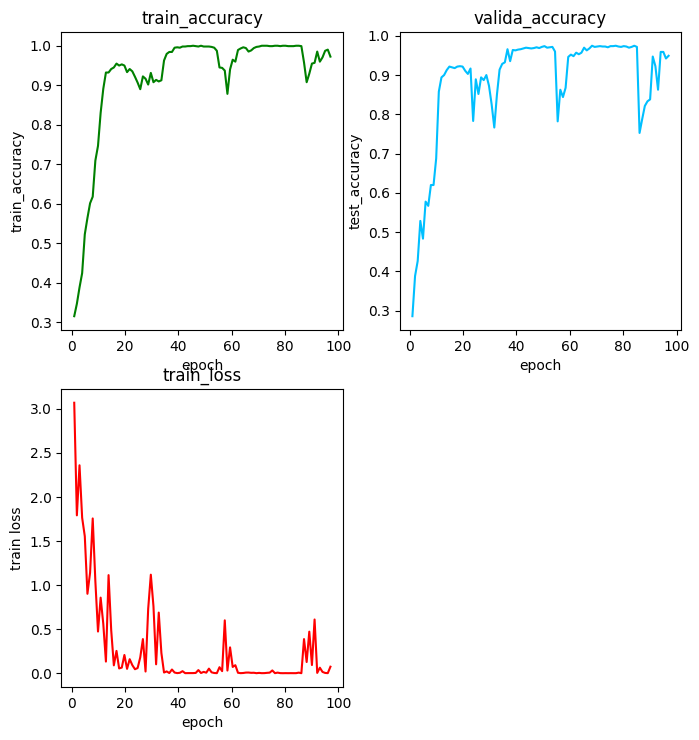

epoch 98, loss 0.0738, train acc 0.972, time 961.4 sec


In [ ]:
# Iterating through multiple runs
for iteration_index in range(ITER):
    print('iter:', iteration_index)

    # Define the network model
    network_model = SSRN_network(BAND, CLASSES_NUM)
    optimizer = torch.optim.Adam(list(network_model.parameters()) + list(model_vit.parameters()), lr=1e-3, betas=(0.9, 0.999), eps=1e-8, weight_decay=0)

    # Seed initialization
    start_time = int(time.time())
    np.random.seed(seeds[iteration_index])

    # Data sampling for training and testing
    train_indices, test_indices = sampling(VALIDATION_SPLIT, gt)
    _, total_indices = sampling(1, gt)
    _, total_indicesbg = sampling(1, gt, bg=True)
    TOTAL_SIZEBG = 21025

    # Compute dataset sizes
    train_size = len(train_indices)
    test_size = TOTAL_SIZE - train_size
    validation_size = int(train_size)

    print('Train size: ', train_size)
    print('Test size: ', test_size)
    print('Validation size: ', validation_size)

    print('-----Selecting Small Pieces from the Original Cube Data-----')
    # Generate data iterators
    train_iter, valida_iter, test_iter, all_iter, all_iter_bg = generate_iter(train_size, train_indices, test_size, test_indices, TOTAL_SIZE, total_indices, TOTAL_SIZEBG, total_indicesbg, validation_size, whole_data, PATCH_LENGTH, padded_data, INPUT_DIMENSION, 16, gt)  # batchsize in 1

    # Training the model
    training_start_time = time.time()
    train(network_model, model_vit, train_iter, valida_iter, loss, optimizer, device, epochs=100)
    training_end_time = time.time()

    # Testing the model
    pred_test = []
    testing_start_time = time.time()
    with torch.no_grad():
        for X, y in test_iter:
            X = X.to(device)
            network_model.eval()
            model_vit.eval()
            y_hat = network_model(X)
            y_hat = model_vit(y_hat)
            y_hat_cpu = y_hat.cpu()
            pred_test.extend(np.array(y_hat_cpu.argmax(axis=1)))
    testing_end_time = time.time()

    # Compute evaluation metrics
    ground_truth_test = gt[test_indices] - 1
    overall_accuracy = metrics.accuracy_score(pred_test, ground_truth_test[:-validation_size])
    confusion_matrix = metrics.confusion_matrix(pred_test, ground_truth_test[:-validation_size])
    each_class_accuracy, average_accuracy = aa_and_each_accuracy(confusion_matrix)
    cohen_kappa = metrics.cohen_kappa_score(pred_test, ground_truth_test[:-validation_size])

    # Save model checkpoint
    torch.save(network_model.state_dict(), "./content/" + str(round(overall_accuracy, 3)) + '.pt')

    # Update performance metrics lists
    KAPPA.append(cohen_kappa)
    OA.append(overall_accuracy)
    AA.append(average_accuracy)
    TRAINING_TIME.append(training_end_time - training_start_time)
    TESTING_TIME.append(testing_end_time - testing_start_time)
    ELEMENT_ACC[iteration_index, :] = each_class_accuracy


#### Saving the model

In [ ]:
torch.save(network_model.state_dict(), f"./content/SSRN_Hyperspectral_IN.pt")
torch.save(model_vit.state_dict(), f"./content/ViT_Hyperspectral_IN.pt")

### Output

#### Load Models

In [ ]:
network_model.load_state_dict(torch.load("/content/content/SSRN_Hyperspectral_IN.pt"))
model_vit.load_state_dict(torch.load("/content/content/ViT_Hyperspectral_IN.pt"))

<All keys matched successfully>

#### Classification Map Generation and Accuracy Calculation

In [ ]:
# Function to set the figure size for plotting
import matplotlib_inline.backend_inline

def set_figsize(figsize=(3.5, 2.5)):
    """
    Sets the figure size for matplotlib plots.

    Args:
    - figsize (tuple): Tuple specifying the width and height of the figure in inches.
    """
    matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
    plt.rcParams['figure.figsize'] = figsize

# Function to create a classification map from predicted labels
def classification_map(map, ground_truth, dpi, save_path):
    """
    Generates a classification map and saves it as an image.

    Args:
    - map (numpy.ndarray): Array representing the classification map.
    - ground_truth (numpy.ndarray): Ground truth data for comparison.
    - dpi (int): Dots per inch for the saved image.
    - save_path (str): Path to save the generated image.
    """
    # Create a figure and axis for plotting
    fig = plt.figure(frameon=False)
    fig.set_size_inches(ground_truth.shape[1] * 2.0 / dpi, ground_truth.shape[0] * 2.0 / dpi)
    ax = plt.Axes(fig, [0., 0., 1., 1.])
    ax.set_axis_off()
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
    fig.add_axes(ax)

    # Plot the classification map
    ax.imshow(map)

    # Save the plot to the specified path
    fig.savefig(save_path, dpi=dpi)

    return 0

# Function to convert a list of labels to a colormap for visualization
def list_to_colormap(x_list):
    """
    Converts a list of labels to a colormap for visualization.

    Args:
    - x_list (numpy.ndarray): List of labels to be converted to a colormap.

    Returns:
    - colormap (numpy.ndarray): Array representing the colormap.
    """
    colormap = np.zeros((x_list.shape[0], 3))
    for index, item in enumerate(x_list):
        # Map each label to a color in the colormap
        if item == 0:
            colormap[index] = np.array([255, 0, 0]) / 255.
        if item == 1:
            colormap[index] = np.array([0, 255, 0]) / 255.
        if item == 2:
            colormap[index] = np.array([0, 0, 255]) / 255.
        if item == 3:
            colormap[index] = np.array([255, 255, 0]) / 255.
        if item == 4:
            colormap[index] = np.array([0, 255, 255]) / 255.
        if item == 5:
            colormap[index] = np.array([255, 0, 255]) / 255.
        if item == 6:
            colormap[index] = np.array([192, 192, 192]) / 255.
        if item == 7:
            colormap[index] = np.array([128, 128, 128]) / 255.
        if item == 8:
            colormap[index] = np.array([128, 0, 0]) / 255.
        if item == 9:
            colormap[index] = np.array([128, 128, 0]) / 255.
        if item == 10:
            colormap[index] = np.array([0, 128, 0]) / 255.
        if item == 11:
            colormap[index] = np.array([128, 0, 128]) / 255.
        if item == 12:
            colormap[index] = np.array([0, 128, 128]) / 255.
        if item == 13:
            colormap[index] = np.array([0, 0, 128]) / 255.
        if item == 14:
            colormap[index] = np.array([255, 165, 0]) / 255.
        if item == 15:
            colormap[index] = np.array([255, 215, 0]) / 255.
        if item == 16:
            colormap[index] = np.array([0, 0, 0]) / 255.
        if item == 17:
            colormap[index] = np.array([215, 255, 0]) / 255.
        if item == 18:
            colormap[index] = np.array([0, 255, 215]) / 255.
        if item == -1:
            colormap[index] = np.array([0, 0, 0]) / 255.
    return colormap

# Function to generate and save classification maps for the dataset
def generate_png(all_iter, net, model_vit, gt_hsi, dataset_name, device, total_indices):
    """
    Generates and saves classification maps for the dataset.

    Args:
    - all_iter: Iterator containing data for classification.
    - net: Neural network model for prediction.
    - model_vit: Vision Transformer model for additional processing.
    - gt_hsi: Ground truth hyperspectral image data.
    - dataset_name (str): Name of the dataset.
    - device: Device for computation (e.g., 'cuda' or 'cpu').
    - total_indices: Indices for the total dataset.

    Returns:
    - None
    """
    predicted_labels = []
    for X, colormap in all_iter:
        #X = X.permute(0, 3, 1, 2)
        X = X.to(device)
        net.eval()
        model_vit.eval()
        y_hat = net(X)
        y_hat = model_vit(y_hat)
        predicted_labels.extend(y_hat.cpu().argmax(axis=1).detach().numpy())

    gt = gt_hsi.flatten()
    label_map = np.zeros(gt.shape)
    gt = gt[:] - 1
    label_map[total_indices] = predicted_labels
    flattened_label_map = np.ravel(label_map)
    colormap_predicted = list_to_colormap(flattened_label_map)

    # Modify ground truth colormap to exclude background class
    colormap_ground_truth_modified = []
    for xx, yy in zip(flattened_label_map, gt):
        if yy == 255:
            colormap_ground_truth_modified.append(16)
        else:
            colormap_ground_truth_modified.append(xx)
    colormap_ground_truth_modified = np.array(colormap_ground_truth_modified)

    # Generating and Saving Classification Maps
    colormap_ground_truth = list_to_colormap(gt)
    reshaped_colormap_predicted = np.reshape(colormap_predicted, (gt_hsi.shape[0], gt_hsi.shape[1], 3))
    reshaped_colormap_ground_truth_modified = np.reshape(list_to_colormap(colormap_ground_truth_modified), (gt_hsi.shape[0], gt_hsi.shape[1], 3))
    reshaped_colormap_ground_truth = np.reshape(colormap_ground_truth, (gt_hsi.shape[0], gt_hsi.shape[1], 3))
    path = './content/'

    # Save predicted classification map
    predicted_map_path = path + '/classification_maps/' + dataset_name + '_BG' + '.png'
    classification_map(reshaped_colormap_predicted, gt_hsi, 85, predicted_map_path)
    print("Predicted Classification Map as with Background class:", predicted_map_path)

    # Save modified ground truth classification map
    modified_gt_map_path = path + '/classification_maps/' + dataset_name + '_' + '.png'
    classification_map(reshaped_colormap_ground_truth_modified, gt_hsi, 85, modified_gt_map_path)
    print("Modified Ground Truth Classification Map as:", modified_gt_map_path)

    # Save original ground truth classification map
    gt_map_path = path + '/classification_maps/' + dataset_name + '_gt.png'
    classification_map(reshaped_colormap_ground_truth, gt_hsi, 85, gt_map_path)
    print("Original Ground Truth Classification Map as:", gt_map_path)

    print('------Get classification maps successful-------')

    # Function to calculate accuracy between classified map and ground truth map
    def calculate_accuracy(classified_map, ground_truth):
        """
        Calculates the accuracy between a classified map and ground truth map.

        Args:
        - classified_map (numpy.ndarray): Classified map data.
        - ground_truth (numpy.ndarray): Ground truth map data.

        Returns:
        - accuracy (float): Accuracy value between 0 and 1.
        """
        # Flatten the maps for comparison
        classified_flat = classified_map.flatten()
        ground_truth_flat = ground_truth.flatten()

        # Calculate accuracy
        accuracy = np.mean(classified_flat == ground_truth_flat)

        return accuracy

    # Usage example:
    # Assuming 'classified_map' and 'ground_truth_map' are the classification maps and ground truth maps respectively
    acc = calculate_accuracy(colormap_ground_truth, reshaped_colormap_ground_truth_modified)
    print(f"Accuracy of Without Background Class with Ground Truth: {round((acc)*100, 4)} %")
    acc = calculate_accuracy(colormap_ground_truth, reshaped_colormap_predicted)
    print(f"Accuracy of With Background Class with Ground Truth: {round((acc)*100, 4)} %")


#### Function to Record Evaluation Metrics and Results

In [ ]:
def record_output(overall_accuracies, average_accuracies, kappas, element_accuracies, training_times, testing_times, confusion_matrix, path):
    """
    Records the evaluation metrics and results to a text file.

    Args:
    - overall_accuracies (list): List of overall accuracies for each iteration.
    - average_accuracies (list): List of average accuracies for each iteration.
    - kappas (list): List of Kappa coefficients for each iteration.
    - element_accuracies (numpy array): Array containing accuracies for each class across iterations.
    - training_times (list): List of training times for each iteration.
    - testing_times (list): List of testing times for each iteration.
    - confusion_matrix (numpy array): The confusion matrix.
    - path (str): Path to the output text file.

    Returns:
    - None
    """
    # Open the file in append mode
    f = open(path, 'a')

    # Write overall accuracies, average accuracies, and Kappa coefficients for each iteration
    sentence0 = 'OAs for each iteration are:' + str(overall_accuracies) + '\n'
    f.write(sentence0)
    sentence1 = 'AAs for each iteration are:' + str(average_accuracies) + '\n'
    f.write(sentence1)
    sentence2 = 'KAPPAs for each iteration are:' + str(kappas) + '\n' + '\n'
    f.write(sentence2)

    # Calculate and write mean and standard deviation of overall accuracies, average accuracies, and Kappa coefficients
    sentence3 = 'mean_OA ± std_OA is: ' + str(np.mean(overall_accuracies)) + ' ± ' + str(np.std(overall_accuracies)) + '\n'
    f.write(sentence3)
    sentence4 = 'mean_AA ± std_AA is: ' + str(np.mean(average_accuracies)) + ' ± ' + str(np.std(average_accuracies)) + '\n'
    f.write(sentence4)
    sentence5 = 'mean_KAPPA ± std_KAPPA is: ' + str(np.mean(kappas)) + ' ± ' + str(np.std(kappas)) + '\n' + '\n'
    f.write(sentence5)

    # Write total average training and testing times
    sentence6 = 'Total average Training time is: ' + str(np.sum(training_times)) + '\n'
    f.write(sentence6)
    sentence7 = 'Total average Testing time is: ' + str(np.sum(testing_times)) + '\n' + '\n'
    f.write(sentence7)

    # Calculate and write mean and standard deviation of element accuracies in confusion matrix
    element_mean = np.mean(element_accuracies, axis=0)
    element_std = np.std(element_accuracies, axis=0)
    sentence8 = "Mean of all elements in confusion matrix: " + str(element_mean) + '\n'
    f.write(sentence8)
    sentence9 = "Standard deviation of all elements in confusion matrix: " + str(element_std) + '\n'
    f.write(sentence9)

    # Write the diagonal of the confusion matrix
    sentence10 = "The diagonal Confusion matrix: " + '\n' + str(confusion_matrix) + '\n'
    f.write(sentence10)

    # Close the file
    f.close()


#### Evaluation Results Recording and Visualization Generation with Accuracy

-------- Training Finished-----------
Predicted Classification Map as with Background class: ./content//classification_maps/IN_BG.png
Modified Ground Truth Classification Map as: ./content//classification_maps/IN_.png
Original Ground Truth Classification Map as: ./content//classification_maps/IN_gt.png
------Get classification maps successful-------
Accuracy of Without Background Class with Ground Truth: 98.6936 %
Accuracy of With Background Class with Ground Truth: 70.627 %


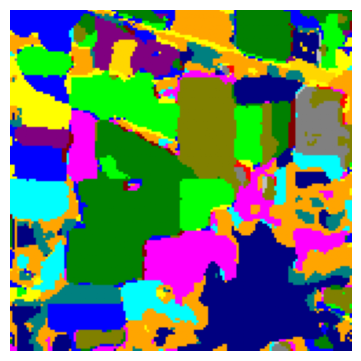

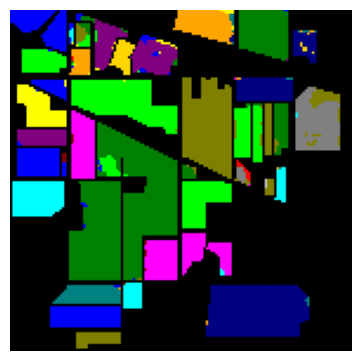

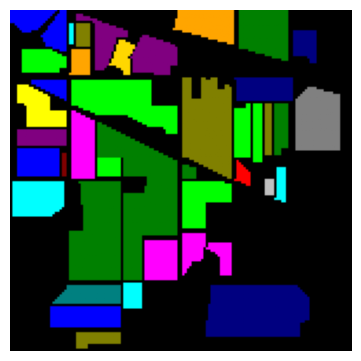

In [ ]:
print("--------" + " Training Finished-----------")

# Record evaluation metrics and results using the record_output function
record_output(OA, AA, KAPPA, ELEMENT_ACC, TRAINING_TIME, TESTING_TIME,confusion_matrix,
                     './content/'  + str(img_rows) + '_' + Dataset + 'split：' + str(VALIDATION_SPLIT) + 'lr：' + str(lr) + '.txt')

# Generate classification maps with background using generate_png function
generate_png(all_iter_bg, network_model, model_vit, gt_hsi, Dataset, device, total_indicesbg)
